In [1]:
# !pip install folium

# 한글폰트

In [2]:
from matplotlib import rc, font_manager as fm

# 나눔고딕 폰트 경로 설정
font_path = 'data/나눔고딕/NanumFontSetup_TTF_GOTHIC/NanumGothic.ttf'
font_name = fm.FontProperties(fname=font_path).get_name()

# 폰트 설정
rc('font', family=font_name)

In [3]:
import folium
import pandas as pd

In [4]:
# 강남역(서울열린데이터 제공 좌표)
# 위도
latitude = 37.4974135
# 경도
longitude = 127.028008

m = folium.Map(location=[latitude, longitude],
               zoom_start=15, 
               width=750, 
               height=500
              )
m

## 좌표 마킹하기

In [5]:

folium.Marker([latitude, longitude],
              popup="강남역",
              tooltip="강남역").add_to(m)
m

## 좌표 스타일 바꾸기

In [6]:
folium.Marker([latitude, longitude],
              popup="강남역",
              tooltip="강남역", 
              icon=folium.Icon('red', icon='star'),
             ).add_to(m)
m

## 반경 정보도 설정 가능

In [7]:
folium.CircleMarker([latitude, longitude],
                    color='skyblue',
                    radius = 200, 
                    tooltip='강남역 상권').add_to(m)
m

## 유튜브 영상도 추가 가능..!

In [8]:
folium.Marker([latitude, longitude],
              popup='<iframe width="560" height="315" src="https://www.youtube.com/embed/KX8Y1NfKvCg" title="YouTube video player" frameborder="0" allow="accelerometer; autoplay; clipboard-write; encrypted-media; gyroscope; picture-in-picture" allowfullscreen></iframe>',
              tooltip="강남역 뉴스").add_to(m)
m

# 서울시 상가 현황

In [9]:
df = pd.read_csv('data/소상공인시장진흥공단_상가(상권)정보_20230630 (1)/소상공인시장진흥공단_상가(상권)정보_서울_202306.csv', encoding='utf-8')
df.info()

C:\Users\user\AppData\Local\Temp\ipykernel_7856\2252575509.py:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('data/소상공인시장진흥공단_상가(상권)정보_20230630 (1)/소상공인시장진흥공단_상가(상권)정보_서울_202306.csv', encoding='utf-8')


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 489903 entries, 0 to 489902
Data columns (total 39 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   상가업소번호     489903 non-null  object 
 1   상호명        489903 non-null  object 
 2   지점명        6082 non-null    object 
 3   상권업종대분류코드  489903 non-null  object 
 4   상권업종대분류명   489903 non-null  object 
 5   상권업종중분류코드  489903 non-null  object 
 6   상권업종중분류명   489903 non-null  object 
 7   상권업종소분류코드  489903 non-null  object 
 8   상권업종소분류명   489903 non-null  object 
 9   표준산업분류코드   489833 non-null  object 
 10  표준산업분류명    489833 non-null  object 
 11  시도코드       489903 non-null  int64  
 12  시도명        489903 non-null  object 
 13  시군구코드      489903 non-null  int64  
 14  시군구명       489903 non-null  object 
 15  행정동코드      489903 non-null  int64  
 16  행정동명       489903 non-null  object 
 17  법정동코드      489903 non-null  int64  
 18  법정동명       489903 non-null  object 
 19  지번코드       489903 non-n

In [10]:
sub_df = df[['위도', '경도', '상호명']].head(30000)
sub_df

,위도,경도,상호명
0,37.568503,127.082832,영자's곱창
1,37.565708,127.005849,호텔클로이
2,37.649226,127.076956,나라차중계태권도장
3,37.542117,126.828832,이상한스냅
4,37.560053,126.833022,토끼정
...,...,...,...
29995,37.540273,126.834552,너와나에프엔비
29996,37.596202,127.041091,에고펫
29997,37.567130,126.980349,여행학교
29998,37.607099,127.106981,똑똑카페


In [11]:
from folium.plugins import MarkerCluster


m = folium.Map(
    location=[latitude, longitude],
    zoom_start=15
)

coords = sub_df[['위도', '경도']]


marker_cluster = MarkerCluster().add_to(m)

for lat, long in zip(coords['위도'], coords['경도']):
    folium.Marker([lat, long], icon = folium.Icon(color="green")).add_to(marker_cluster)
m

# 서울 구단위 표시

In [12]:
import requests
import json

# 서울 행정구역 json raw파일(githubcontent)
r = requests.get('https://raw.githubusercontent.com/southkorea/seoul-maps/master/kostat/2013/json/seoul_municipalities_geo_simple.json')
c = r.content
seoul_geo = json.loads(c)

In [13]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

m

# 지도 테마 변경(백지도)

In [14]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
    tiles='Stamen Toner'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

m

# cartodbpositron 적용

In [15]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
    tiles='cartodbpositron'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

m

# 서울시 자치구별 상권정보 시각화

In [16]:
df2 = df[['위도', '경도', '상권업종대분류명', '상권업종중분류명']]
selected_value = df2.iloc[0:20]['상권업종중분류명']
selected_value

0              한식
1           일반 숙박
2           기타 교육
3           사진 촬영
4              한식
5              한식
6           기타 간이
7       의약·화장품 소매
8              광고
9         운송장비 대여
10          비알코올 
11          기타 교육
12          기타 간이
13    섬유·의복·신발 소매
14             한식
15      의약·화장품 소매
16          사진 촬영
17          기타 간이
18        욕탕·신체관리
19          종합 소매
Name: 상권업종중분류명, dtype: object

# 업종별 수 파악하기(중분류 기준)

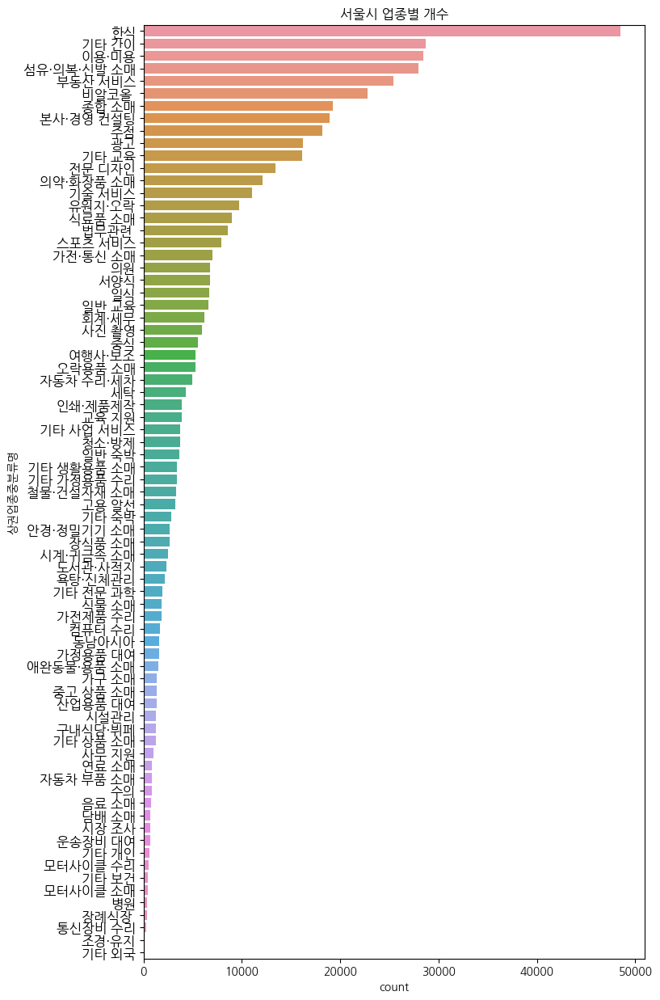

In [17]:
import matplotlib.pyplot as plt
import seaborn as sns


plt.figure(figsize=(8, 15))
sns.countplot(y=df2['상권업종중분류명'], order=df2['상권업종중분류명'].value_counts().index)
plt.yticks(fontsize=12)
plt.title('서울시 업종별 개수')
plt.show()

### 먼저 이 자료에서의 카페는 음식점엄(대분류) - 비알코올 음료점업(중분류) - 카페(소분류)로 이루어져있다.
### 카페의 분포를 폴리움에서 시각적으로 표현하능 방법을 알아보자

In [18]:
# 다소 킹받는 비알코올v 왜 안뜨나 했네...
seoul_cafe = df2.loc[df2['상권업종중분류명'] == '비알코올 ']
seoul_cafe

,위도,경도,상권업종대분류명,상권업종중분류명
10,37.446689,126.909939,음식,비알코올
33,37.484021,127.120954,음식,비알코올
80,37.598493,127.056962,음식,비알코올
82,37.530474,127.125070,음식,비알코올
110,37.516746,127.040820,음식,비알코올
...,...,...,...,...
489802,37.587098,127.026341,음식,비알코올
489812,37.529604,126.968200,음식,비알코올
489835,37.488413,127.014077,음식,비알코올
489855,37.510491,127.108473,음식,비알코올


# 지역구 단위별 비알코올 분포 현황 파악하기

In [19]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=12, 
    tiles='cartodbpositron'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

marker_cluster = MarkerCluster().add_to(m)

for lat, long in zip(seoul_cafe['위도'], seoul_cafe['경도']):
    folium.Marker([lat, long], icon = folium.Icon(color="green")).add_to(marker_cluster)

m

## 서울시 구별 카페 개수

In [20]:
seoul_sgn_cafe = df.loc[df['상권업종중분류명'] == '비알코올 '].groupby('시군구명')['상권업종중분류명'].count()
seoul_sgn_cafe

시군구명
강남구     2131
강동구      744
강북구      530
강서구     1057
관악구      826
광진구      827
구로구      608
금천구      573
노원구      676
도봉구      397
동대문구     716
동작구      630
마포구     2022
서대문구     695
서초구     1218
성동구      821
성북구      817
송파구     1443
양천구      595
영등포구    1133
용산구      845
은평구      679
종로구     1253
중구      1028
중랑구      555
Name: 상권업종중분류명, dtype: int64

## choropleth 를 사용하여 개수에 따른 색상의 차이를 두어 시각화가 가능

In [21]:
m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
    tiles='cartodbpositron'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

m.choropleth(geo_data=seoul_geo,
             data=seoul_sgn_cafe, 
             fill_color='YlOrRd', # 색상 변경도 가능하다
             fill_opacity=0.5,
             line_opacity=0.2,
             key_on='properties.name',
             legend_name="지역구별 카페 수"
            )
m

C:\Users\user\AppData\Local\Programs\Python\Python39\lib\site-packages\folium\folium.py:465: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


## bins 변수를 선언하여 4분위수로 구간을 나누어 시각화

In [22]:
bins = list(seoul_group_data.quantile([0, 0.25, 0.5, 0.75, 1]))

m = folium.Map(
    location=[37.559819, 126.963895],
    zoom_start=11, 
    tiles='cartodbpositron'
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

m.choropleth(geo_data=seoul_geo,
             data=seoul_sgn_cafe, 
             fill_color='YlOrRd', # 색상 변경도 가능하다
             fill_opacity=0.5,
             line_opacity=0.2,
             key_on='properties.name',
             legend_name="지역구별 카페 수", 
             bins=bins
            )
m

NameError: name 'seoul_group_data' is not defined

In [ ]:
### 공부 계속
### https://teddylee777.github.io/visualization/folium/#cartodbpositron-%EC%A0%81%EC%9A%A9%EC%8B%9C